In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 68889, done.
remote: Total 68889 (delta 0), reused 0 (delta 0), pack-reused 68889
Receiving objects: 100% (68889/68889), 577.12 MiB | 23.61 MiB/s, done.
Resolving deltas: 100% (48535/48535), done.


In [ ]:
%%bash
cd /content/models/research/
git checkout ab70b0f22d7825f85d47de474a77d9a723d4a84e


Note: checking out 'ab70b0f22d7825f85d47de474a77d9a723d4a84e'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now at ab70b0f22 Internal change


In [ ]:
# write to the file 
setup_file = '/content/models/research/object_detection/packages/tf2/setup.py'

setup_file_content = '''
import os
from setuptools import find_packages
from setuptools import setup

# Note: adding apache-beam to required packages causes conflict with
# tf-models-offical requirements. These packages request for incompatible
# oauth2client package.
REQUIRED_PACKAGES = [
    # Required for apache-beam with PY3
    'avro-python3',
    'apache-beam',
    'pillow',
    'lxml',
    'matplotlib',
    'Cython',
    'contextlib2',
    'tf-slim',
    'six',
    'pycocotools',
    'lvis',
    'scipy',
    'pandas',
    'tf-models-official>=2.5.1',
    'numpy==1.21.5',
    'tensorflow==2.7.0',
    'opencv-python-headless==4.1.2.30',
]

setup(
    name='object_detection',
    version='0.1',
    install_requires=REQUIRED_PACKAGES,
    include_package_data=True,
    packages=(
        [p for p in find_packages() if p.startswith('object_detection')] +
        find_packages(where=os.path.join('.', 'slim'))),
    package_dir={
        'datasets': os.path.join('slim', 'datasets'),
        'nets': os.path.join('slim', 'nets'),
        'preprocessing': os.path.join('slim', 'preprocessing'),
        'deployment': os.path.join('slim', 'deployment'),
        'scripts': os.path.join('slim', 'scripts'),
    },
    description='Tensorflow Object Detection Library',
    python_requires='>3.6',
)

'''
with open(setup_file , 'w') as f:
  f.write(setup_file_content)

In [ ]:
%%bash
cd /content/models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .

#python -m pip uninstall numpy --yes 
#python -m pip install numpy==1.15.4
python -m pip install .
#python -m pip uninstall opencv-python-headless --yes 
#python -m pip install opencv-python-headless==4.1.2.30 



Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1675769 sha256=7527f8bf9273cfcd104ef9b2bc766bec0d88603fc4444733c86cc63acef0c23a
  Stored in directory: /tmp/pip-ephem-wheel-cache-1ufkgb73/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22257 sha256=0556cd8db2a722d8fde51781c601e270c84d8e6b19a72bb7b3727eee38716918
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for avro-python3: filename=avro_python3-1.9.2.1-py3-none-any.whl size=43513 sha256=3a2fbc1b76374ca69630ce5ef9e2054122c52469689d1dfb8bdd7d1ee40e13b5
  Stored in directory: /root/.cache/pip/wheels/bc/49/5f/fdb5b9d85055c478213e0158ac122b596816149a02d82e0ab1
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=94a56fc10934a25c7d7ec8e0769d86139710de32b1401c121

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.3.post1 requires numpy<1.20,>=1.16.0, but you have numpy 1.21.5 which is incompatible.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

In [ ]:
!git clone https://dsharma080:<token>@github.com/dsharma080/fod.git

Cloning into 'fod'...
remote: Enumerating objects: 889, done.
remote: Counting objects: 100% (386/386), done.
remote: Compressing objects: 100% (221/221), done.
remote: Total 889 (delta 182), reused 356 (delta 163), pack-reused 503
Receiving objects: 100% (889/889), 3.07 GiB | 34.12 MiB/s, done.
Resolving deltas: 100% (346/346), done.


In [ ]:
test_record_fname = '/content/fod/tfrecords/train.tfrecord'
train_record_fname = '/content/fod/tfrecords/train.tfrecord'
label_map_pbtxt_fname = '/content/fod/tfrecords/labelmap.pbtxt'

In [ ]:
!cat '/content/fod/tfrecords//labelmap.pbtxt'

item {
  id: 1
  name: 'NUT1'
}


In [ ]:
#You can change chosen model to deploy different models available in the TF2 object detection zoo
MODELS_CONFIG = {
    'ssd_mobilenet_v2_320x320_coco17': {
        'model_name': 'ssd_mobilenet_v2_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz',
        'batch_size': 16
    }
}
chosen_model = 'ssd_mobilenet_v2_320x320_coco17'
num_steps = 1500 #40000 #The more steps, the longer the training. Increase if your loss function is still decreasing and validation metrics are increasing. 
num_eval_steps = 100 #Perform evaluation after so many steps
model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
batch_size = MODELS_CONFIG[chosen_model]['batch_size'] #if you can fit a large batch in memory, it may speed up your trainin#g

In [ ]:
#Download pretrained weights
%mkdir /content/deploy/
%cd /content/deploy/
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()
#Shorten the folder name,because long file paths are not yet supported :(
os.rename('ssd_mobilenet_v2_320x320_coco17_tpu-8','mobilnetv2')

#Prepare frozen model for retraining
fine_tune_checkpoint = '/content/deploy/mobilnetv2/checkpoint/ckpt-0'
model_dir = '/content/training/'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)

/content/deploy
--2022-02-06 14:28:50--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 209.85.147.128, 2607:f8b0:4001:c20::80
Connecting to download.tensorflow.org (download.tensorflow.org)|209.85.147.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 46042990 (44M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_32 100%[===================>]  43.91M   141MB/s    in 0.3s    

2022-02-06 14:28:50 (141 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’ saved [46042990/46042990]



In [ ]:
# write to the file 
pipeline_file = '/content/deploy/ssd_mobilenet_v2_320x320_coco17_tpu-8.config'
config_content = '''
model {
  ssd {
    num_classes: 1
    image_resizer {
      fixed_shape_resizer {
        height: 300
        width: 300
      }
    }
    feature_extractor {
      type: "ssd_mobilenet_v2_keras"
      depth_multiplier: 1.0
      min_depth: 16
      conv_hyperparams {
        regularizer {
          l2_regularizer {
            weight: 3.9999998989515007e-05
          }
        }
        initializer {
          truncated_normal_initializer {
            mean: 0.0
            stddev: 0.029999999329447746
          }
        }
        activation: RELU_6
        batch_norm {
          decay: 0.9700000286102295
          center: true
          scale: true
          epsilon: 0.0010000000474974513
          train: true
        }
      }
      override_base_feature_extractor_hyperparams: true
    }
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    box_predictor {
      convolutional_box_predictor {
        conv_hyperparams {
          regularizer {
            l2_regularizer {
              weight: 3.9999998989515007e-05
            }
          }
          initializer {
            random_normal_initializer {
              mean: 0.0
              stddev: 0.009999999776482582
            }
          }
          activation: RELU_6
          batch_norm {
            decay: 0.9700000286102295
            center: true
            scale: true
            epsilon: 0.0010000000474974513
            train: true
          }
        }
        min_depth: 0
        max_depth: 0
        num_layers_before_predictor: 0
        use_dropout: false
        dropout_keep_probability: 0.800000011920929
        kernel_size: 1
        box_code_size: 4
        apply_sigmoid_to_scores: false
        class_prediction_bias_init: -4.599999904632568
      }
    }
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6
        min_scale: 0.20000000298023224
        max_scale: 0.949999988079071
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspect_ratios: 0.5
        aspect_ratios: 3.0
        aspect_ratios: 0.33329999446868896
      }
    }
    post_processing {
      batch_non_max_suppression {
        score_threshold: 9.99999993922529e-09
        iou_threshold: 0.6000000238418579
        max_detections_per_class: 100
        max_total_detections: 100
        use_static_shapes: false
      }
      score_converter: SIGMOID
    }
    normalize_loss_by_num_matches: true
    loss {
      localization_loss {
        weighted_smooth_l1 {
          delta: 1.0
        }
      }
      classification_loss {
        weighted_sigmoid_focal {
          gamma: 2.0
          alpha: 0.75
        }
      }
      classification_weight: 1.0
      localization_weight: 1.0
    }
    encode_background_as_zeros: true
    normalize_loc_loss_by_codesize: true
    inplace_batchnorm_update: true
    freeze_batchnorm: false
  }
}
train_config {
  batch_size: 16
  data_augmentation_options {
    
random_horizontal_flip {
  keypoint_flip_permutation: 1
  keypoint_flip_permutation: 0
  keypoint_flip_permutation: 2
  keypoint_flip_permutation: 3
  keypoint_flip_permutation: 5
  keypoint_flip_permutation: 4
  probability: 0.5
}


random_vertical_flip {
  keypoint_flip_permutation: 1
  keypoint_flip_permutation: 0
  keypoint_flip_permutation: 2
  keypoint_flip_permutation: 3
  keypoint_flip_permutation: 5
  keypoint_flip_permutation: 4
  probability: 0.5
}


random_rotation90 {
  keypoint_rot_permutation: 3
  keypoint_rot_permutation: 0
  keypoint_rot_permutation: 1
  keypoint_rot_permutation: 2
  probability: 0.5
}

random_rgb_to_gray {
  probability: 0.8
}

random_adjust_brightness {
  max_delta: 0.2
}

random_adjust_contrast {
  min_delta: 0.7
  max_delta: 1.1
}

random_adjust_hue {
  max_delta: 0.01
}

random_adjust_saturation {
  min_delta: 0.75
  max_delta: 1.15
}

random_jpeg_quality {
  random_coef: 0.5
  min_jpeg_quality: 70
  max_jpeg_quality: 90
}

  }
  sync_replicas: true
  optimizer {
    momentum_optimizer {
      learning_rate {
        cosine_decay_learning_rate {
          learning_rate_base: 0.800000011920929
          total_steps: 50000
          warmup_learning_rate: 0.13333000242710114
          warmup_steps: 2000
        }
      }
      momentum_optimizer_value: 0.8999999761581421
    }
    use_moving_average: false
  }
  fine_tune_checkpoint: "/content/deploy/mobilnetv2/checkpoint/ckpt-0"
  num_steps: 1800
  startup_delay_steps: 0.0
  replicas_to_aggregate: 8
  max_number_of_boxes: 100
  unpad_groundtruth_tensors: false
  fine_tune_checkpoint_type: "detection"
  fine_tune_checkpoint_version: V2
}
train_input_reader {
  label_map_path: "/content/fod/tfrecords/labelmap.pbtxt"
  tf_record_input_reader {
    input_path: "/content/fod/tfrecords/train.tfrecord"
  }
}
eval_config {
  metrics_set: "coco_detection_metrics"
  use_moving_averages: false
}
eval_input_reader {
  label_map_path: "/content/fod/tfrecords/labelmap.pbtxt"
  shuffle: false
  num_epochs: 1
  tf_record_input_reader {
    input_path: "/content/fod/tfrecords/train.tfrecord"
  }
}
'''
with open(pipeline_file , 'w') as f:
  f.write(config_content)

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2022-02-06 14:28:58.556690: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0206 14:28:58.577624 140559762098048 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 1500
I0206 14:28:58.590273 140559762098048 config_util.py:552] Maybe overwriting train_steps: 1500
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0206 14:28:58.590483 140559762098048 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0206 14:28:58.773460 140559762098048 deprecation.py:347] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:558: StrategyBase.experiment

In [ ]:
#run conversion script to save the retrained model:
#Saved model will be in saved_model.pb file:

import re
import numpy as np

output_directory = '/content/fine_tuned_model'

#place the model weights you would like to export here
last_model_path = '/content/training/'
print(last_model_path)
!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

/content/training/
2022-02-06 13:53:17.252765: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0206 13:53:17.427856 140704146892672 deprecation.py:619] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:464: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflo

In [ ]:
import os 
import glob
import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

In [ ]:
#Recover our saved model with the latest checkpoint:
pipeline_config = pipeline_file
#Put the last ckpt from training in here, don't use long pathnames:
model_dir = '/content/training/ckpt-2'
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore last checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
#ckpt.restore(os.path.join(model_dir))
ckpt.restore(model_dir)

#Function perform detection of the object on image in tensor format: 
def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""
    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn
  
#Define function which performs detection: 
detect_fn = get_model_detection_function(detection_model)


#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

In [ ]:
!mkdir /content/fod/predicted_images/

{'IMG_20211222_082023': ['Nut'], 'IMG_20211222_082029': ['Nut'], 'IMG_20211222_082033': ['Nut'], 'IMG_20211222_082037': ['Nut'], 'IMG_20211222_082042': ['Nut'], 'IMG_20211222_082055': ['Nut'], 'IMG_20211222_082102': ['Nut'], 'IMG_20211222_082111': ['Nut'], 'IMG_20211222_082115': ['Nut'], 'IMG_20211222_082117': ['Nut'], 'IMG_20211222_082120': ['Nut'], 'IMG_20211222_082128': ['Nut'], 'IMG_20211222_082129': ['Nut'], 'IMG_20211222_082131': ['Nut'], 'IMG_20211222_082133': ['Nut'], 'IMG_20211222_082216': ['Nut'], 'IMG_20211222_082221': ['Nut'], 'IMG_20211222_082228': ['Nut'], 'IMG_20211222_082234': ['Nut'], 'IMG_20211222_082239': ['Nut'], 'IMG_20211222_082932': ['NutSpring'], 'IMG_20211222_082941': ['NutSpring'], 'IMG_20211222_082949': ['NutSpring'], 'IMG_20211222_082955': ['NutSpring'], 'IMG_20211222_083003': ['NutSpring'], 'IMG_20211222_083010': ['NutSpring'], 'IMG_20211222_083020': ['NutSpring'], 'IMG_20211222_083025': ['NutSpring'], 'IMG_20211222_083028': ['NutSpring'], 'IMG_20211222_083

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


detections (1, 100, 4)
classes (1, 100)
scores (1, 100)
tf.Tensor(
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]], shape=(1, 100), dtype=float32)
detections (1, 100, 4)
classes (1, 100)
scores (1, 100)
tf.Tensor(
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]], shape=(1, 100), dtype=float32)
detections (1, 100, 4)
classes (1, 100)
scores (1, 100)
tf.Tensor(
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

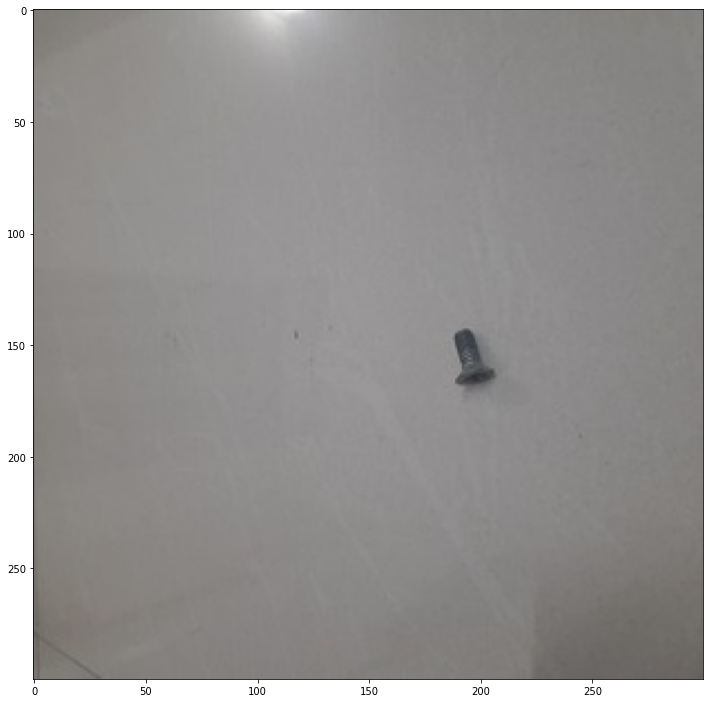

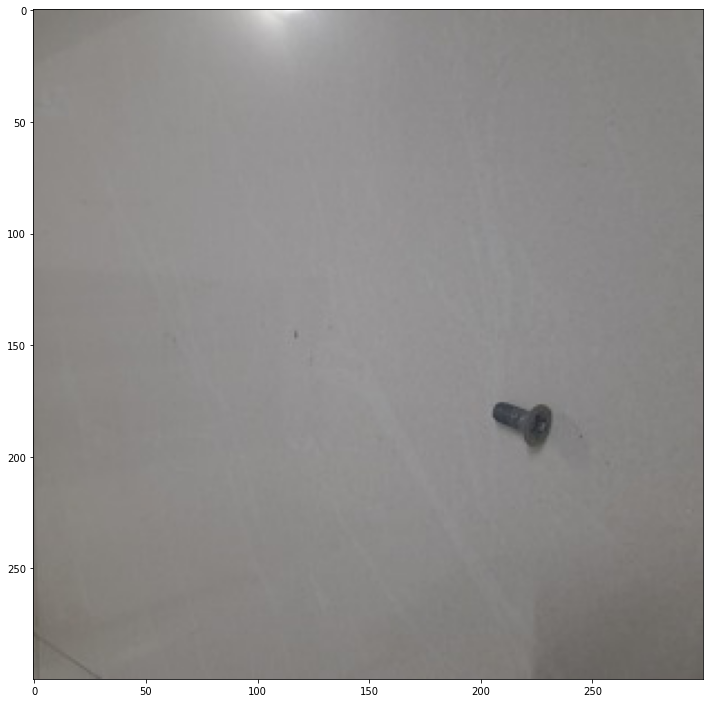

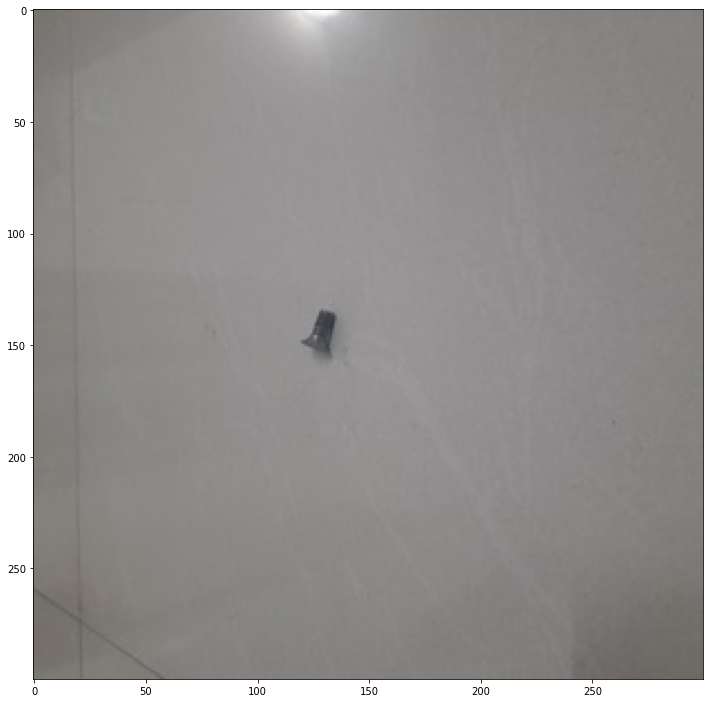

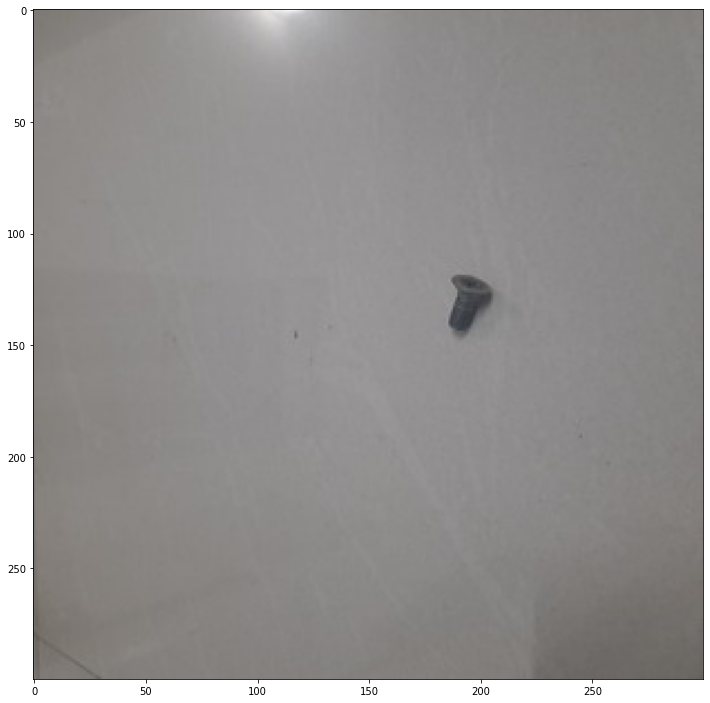

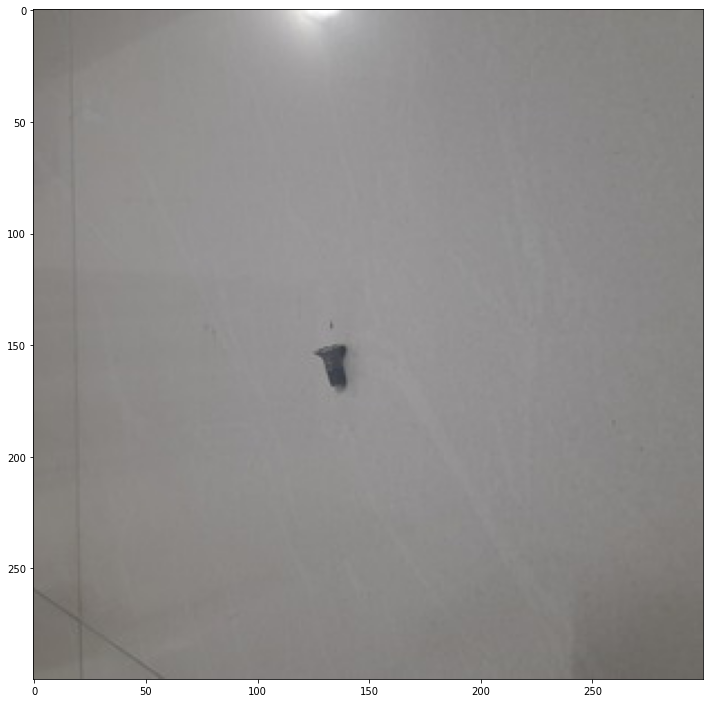

...

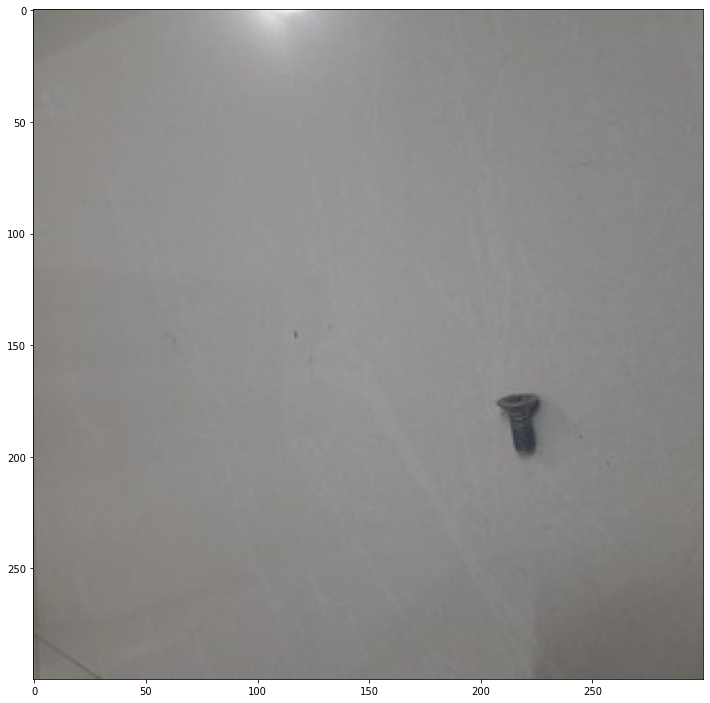

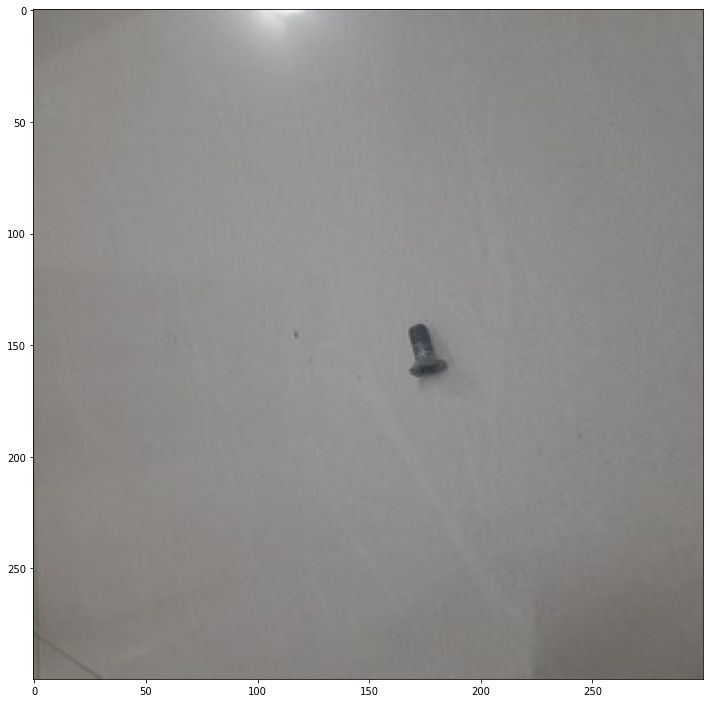

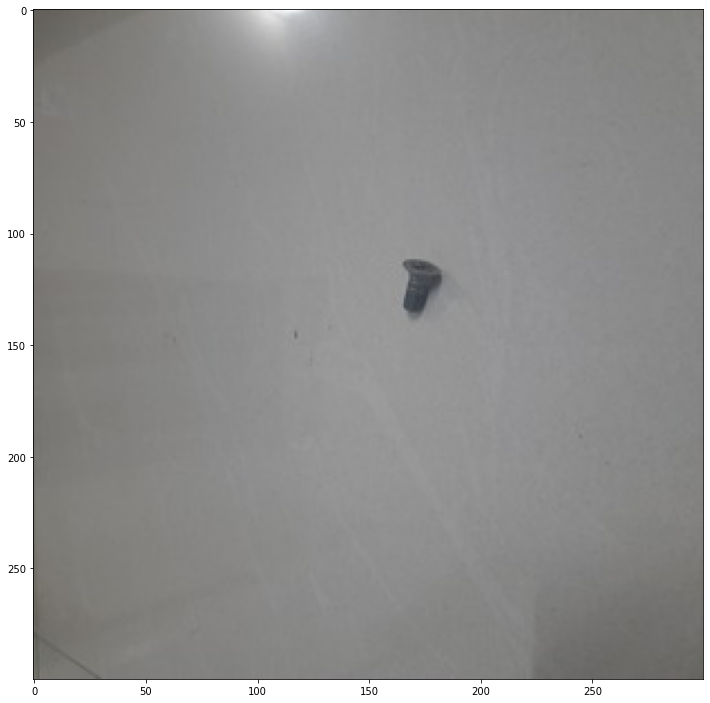

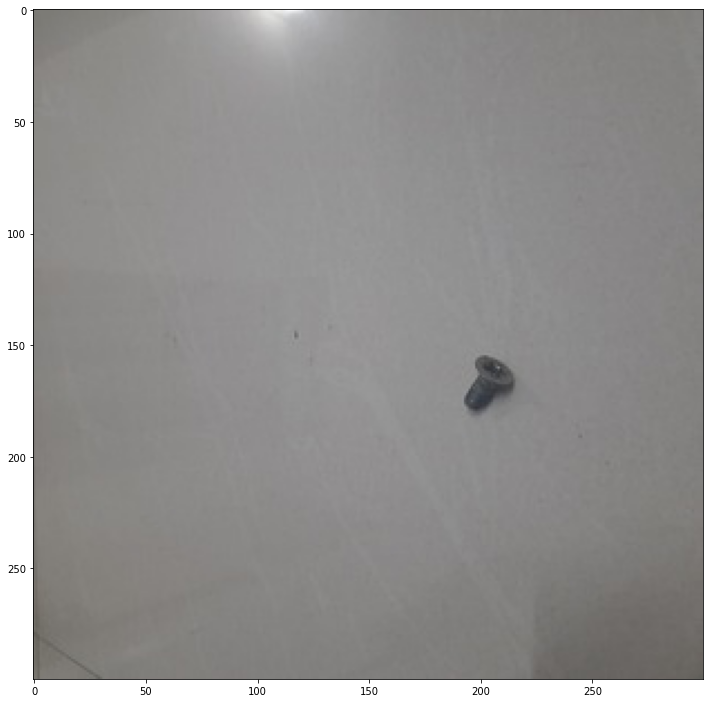

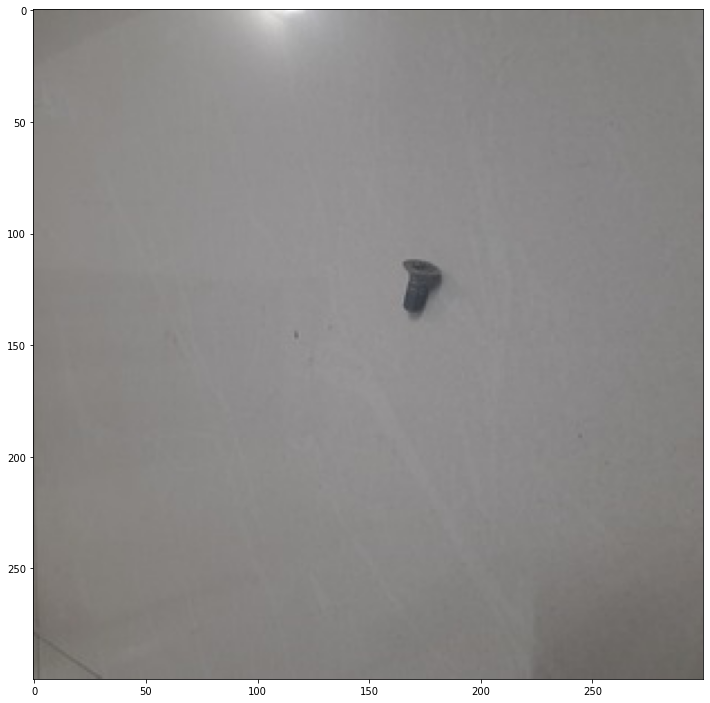

In [ ]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed. 
import random
import os
#Define utility functions for presenting the results:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.
  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.
  Args:
    path: the file path to the image
  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)


def save_image_after_pred(image_path,image_name):
  image_np = load_image_into_numpy_array(image_path)
  input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
  detections, predictions_dict, shapes = detect_fn(input_tensor)
  print("detections",detections['detection_boxes'].shape)
  print("classes",detections['detection_classes'].shape)
  print("scores",detections['detection_scores'].shape)
  label_id_offset = 1
  image_np_with_detections = image_np.copy()
  print(detections['detection_classes'])
  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'][0].numpy(),
        (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
        detections['detection_scores'][0].numpy(),
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=0.5,#0.5,#0.5
        agnostic_mode=False,
  )

  plt.figure(figsize=(12,16))
  plt.imshow(image_np_with_detections)
  plt.savefig('/content/fod/predicted_images/'+image_name)

LABELS_TO_PREDICT = set(['Nut'])

for img in os.listdir("/content/fod/resized_images/"):
    save_image_after_pred('/content/fod/resized_images/'+img,img)

In [ ]:
!cp -r /content/fine_tuned_model/ /content/fod

In [ ]:
%%bash
git config --global user.email 'dsharma080@gmail.com'
git config --global user.name 'dsharma080'
cd /content/fod
#git checkout master
git add fine_tuned_model
git commit -m 'added saved model'  # commit in Colab
git push origin master          # push to github

[master db2eb03] added saved model
 7 files changed, 3 insertions(+), 3 deletions(-)
 rewrite fine_tuned_model/checkpoint/ckpt-0.index (95%)
 rewrite fine_tuned_model/saved_model/variables/variables.index (98%)


To https://github.com/dsharma080/fod.git
   997bb75..db2eb03  master -> master
